<a href="https://colab.research.google.com/github/MedhaGuha08/Automatic-penguin-counting-using-U-Net/blob/main/ECE_471.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ECE 471 - Penguin Counting Project

In [ ]:
import torch
import os
import json
import tarfile
import requests
from skimage import io
from skimage.draw import disk
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from tqdm.auto import tqdm


# Helper function to download and extract a dataset
def download_and_extract(url, destination='.'):
    local_filename = url.split('/')[-1]
    with requests.get(url, stream=True) as r:
        total_length = int(r.headers.get('content-length'))
        with tqdm.wrapattr(r.raw, "read", total=total_length, desc="") as raw:
            with open(local_filename, 'wb') as f:
                f.write(raw.read())

    # Extract the dataset if it is a tar.gz file
    if local_filename.endswith('tgz'):
        with tarfile.open(local_filename, 'r:gz') as tar:
            tar.extractall(path=destination)
        print(f"Extracted {local_filename} to {destination}")



# Download and extract the images
download_and_extract('https://thor.robots.ox.ac.uk/datasets/penguins/CompleteAnnotations_2016-07-11.tgz')
download_and_extract('https://thor.robots.ox.ac.uk/datasets/penguins/BAILa.tgz')
download_and_extract('https://thor.robots.ox.ac.uk/datasets/penguins/DAMOa.tgz')


  0%|          | 0/47256126 [00:00<?, ?it/s]

Extracted CompleteAnnotations_2016-07-11.tgz to .


  0%|          | 0/1778662965 [00:00<?, ?it/s]

Extracted BAILa.tgz to .


  0%|          | 0/190480512 [00:00<?, ?it/s]

Extracted DAMOa.tgz to .


Processed file: DAMOa2014a_000187.JPG
Processed file: DAMOa2014a_000007.JPG
Processed file: DAMOa2014a_000407.JPG
Processed file: DAMOa2014a_000084.JPG


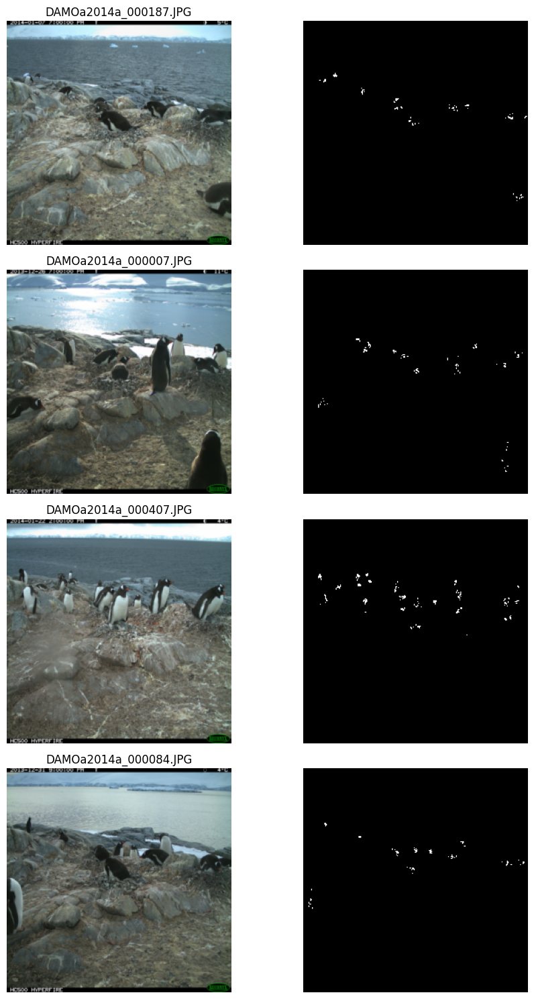

In [ ]:
#wORKING CODE V4
#Dataset Prep
import numpy as np
import matplotlib.pyplot as plt
import torch
import os
import json
import tarfile
import requests
from skimage import io
from skimage.draw import disk
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from tqdm.auto import tqdm

# Define a dataset class
class PenguinDataset(Dataset):
    def __init__(self, annotations_file, img_dir, transform=None):
        with open(annotations_file) as f:
            all_annotations = json.load(f)['dots']
        self.annotations = [ann for ann in all_annotations if ann['xy'] is not None and ann['xy'] != ["_NaN_"]]
        self.img_dir = img_dir
        self.transform = transform

    def __len__(self):
        return len(self.annotations)

    def __getitem__(self, idx):
      annotation = self.annotations[idx]
      img_name = annotation['imName'] + ".JPG"
      img_path = os.path.join(self.img_dir, img_name)

      try:
          image = io.imread(img_path)
      except FileNotFoundError:
          print(f"Image file not found: {img_path}")
          return torch.zeros(3, 256, 256), torch.zeros(1, 256, 256), img_name

      orig_height, orig_width = image.shape[:2]
      mask = np.zeros((orig_height, orig_width), dtype=np.uint8)

      if annotation['xy'] and annotation['xy'] != ["_NaN_"]:
          for point_set in annotation['xy']:
              if not isinstance(point_set, list) or not all(isinstance(point, list) and len(point) == 2 for point in point_set):
                  continue  # Skip non-conforming annotations
              for point in point_set:
                  if len(point) == 2:  # Ensure point is a coordinate pair
                      x, y = point
                      rr, cc = disk((y, x), radius=5, shape=image.shape[:2])
                      mask[rr, cc] = 1

      if self.transform:
          image = self.transform(image)
          mask = self.transform(mask).squeeze(0)  # Remove extra channel dimension added by ToTensor

      return image, mask, img_name

# Define your transforms
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((256, 256)),  # Resize for a consistent input size
    transforms.ToTensor(),  # Convert to tensor for model input
])


# Instantiate the DAMOa dataset
dataset  = PenguinDataset(
    annotations_file='/content/CompleteAnnotations_2016-07-11/DAMOa.json',
    img_dir='/content/DAMOa',
    transform=transform
)

# DataLoader setup
#dataloader = DataLoader(dataset, batch_size=4, shuffle=True, num_workers=0)
#dataloader = DataLoader(dataset, batch_size=4, shuffle=True, num_workers=4)  # Adjust num_workers based on your environment

from torch.utils.data.dataset import random_split

# Split DAMOa dataset
val_size = int(0.2 * len(dataset))
train_size = len(dataset) - val_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

train_dataloader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=4)
val_dataloader = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=4)


# Visualization function
def show_images(images, masks, filenames, num_images=4):
    fig, axs = plt.subplots(num_images, 2, figsize=(10, 15))
    for i in range(num_images):
        axs[i, 0].imshow(images[i].permute(1, 2, 0))
        axs[i, 0].axis('off')
        axs[i, 0].set_title(filenames[i])
        axs[i, 1].imshow(masks[i], cmap='gray')
        axs[i, 1].axis('off')
    plt.tight_layout()
    plt.show()

# Get the first batch
first_batch_images, first_batch_masks, first_batch_filenames = next(iter(train_dataloader))

# Print filenames
for filename in first_batch_filenames:
    print(f"Processed file: {filename}")

# Visualize the first batch
show_images(first_batch_images, first_batch_masks, first_batch_filenames)

In [ ]:
#Model Selection - Simplified U-Net
import torch
import torch.nn as nn
import torch.nn.functional as F

class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1)
        self.relu = nn.ReLU()
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1)

    def forward(self, x):
        return self.relu(self.conv2(self.relu(self.conv1(x))))

class SimplifiedUNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.down1 = ConvBlock(3, 64)
        self.down2 = ConvBlock(64, 128)
        self.up1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.out_conv = nn.Conv2d(64, 1, kernel_size=1)

    def forward(self, x):
        x1 = self.down1(x)
        x2 = F.max_pool2d(x1, 2)
        x3 = self.down2(x2)
        x4 = self.up1(x3)
        return torch.sigmoid(self.out_conv(x4))

# Check if CUDA (GPU support) is available and set the device accordingly
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

model = SimplifiedUNet().to(device)

#Training Setup
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
criterion = nn.BCELoss()




Using device: cuda


In [ ]:
#Training Loop
num_epochs = 300  # Adjust as necessary

for epoch in range(num_epochs):
    for images, masks, _ in train_dataloader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, masks.unsqueeze(1))  # Add channel dimension to masks
        loss.backward()
        optimizer.step()
    print(f"Epoch {epoch+1}, Loss: {loss.item()}")

Epoch 1, Loss: 6.81316596455872e-05
Epoch 2, Loss: 8.548613550374284e-05
Epoch 3, Loss: 7.836311124265194e-05
Epoch 4, Loss: 9.44073690334335e-05
Epoch 5, Loss: 8.852228347677737e-05
Epoch 6, Loss: 7.375532004516572e-05
Epoch 7, Loss: 0.00016302043513860554
Epoch 8, Loss: 9.407334437128156e-05
Epoch 9, Loss: 5.527790926862508e-05
Epoch 10, Loss: 6.999128527240828e-05
Epoch 11, Loss: 8.091027120826766e-05
Epoch 12, Loss: 6.85877530486323e-05
Epoch 13, Loss: 8.177111158147454e-05
Epoch 14, Loss: 6.938426668057218e-05
Epoch 15, Loss: 7.188473682617769e-05
Epoch 16, Loss: 6.637901969952509e-05
Epoch 17, Loss: 7.376701250905171e-05
Epoch 18, Loss: 8.368551061721519e-05
Epoch 19, Loss: 5.0164959247922525e-05
Epoch 20, Loss: 7.81075214035809e-05
Epoch 21, Loss: 0.0001350802049273625
Epoch 22, Loss: 0.00010977148485835642
Epoch 23, Loss: 6.588374526472762e-05
Epoch 24, Loss: 7.151944737415761e-05
Epoch 25, Loss: 9.706579294288531e-05
Epoch 26, Loss: 7.721089787082747e-05
Epoch 27, Loss: 3.2842

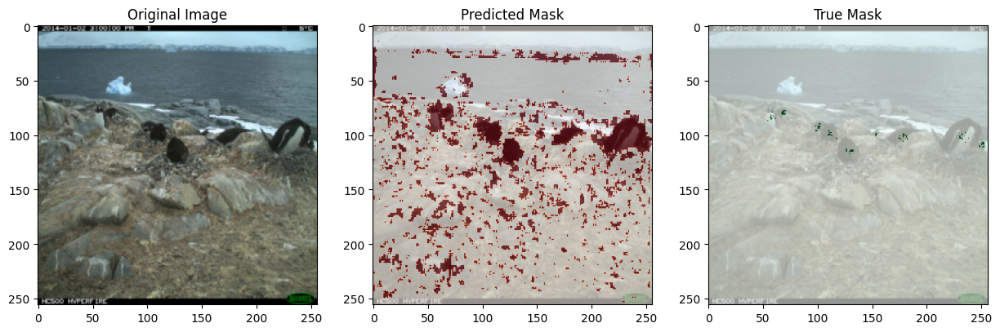

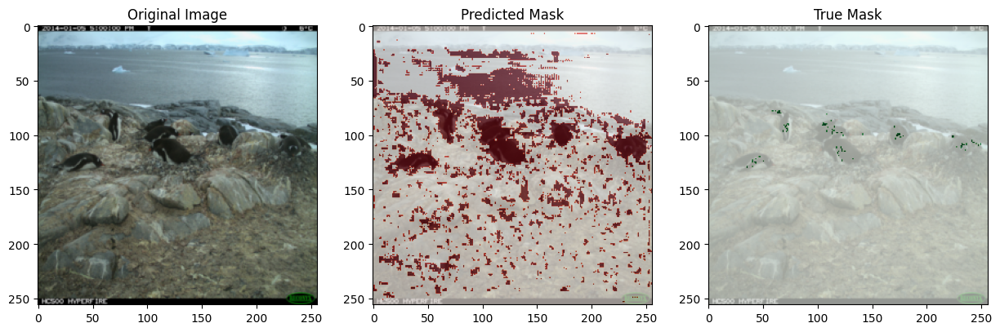

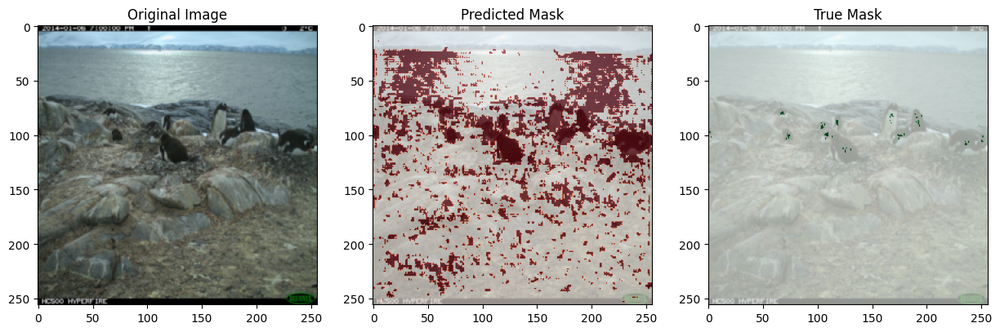

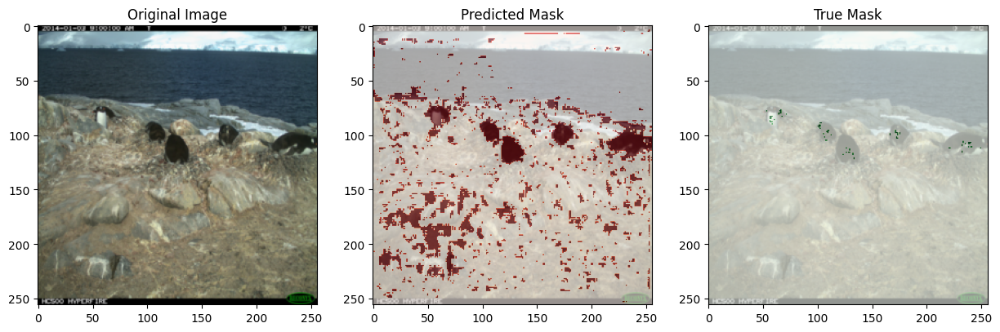

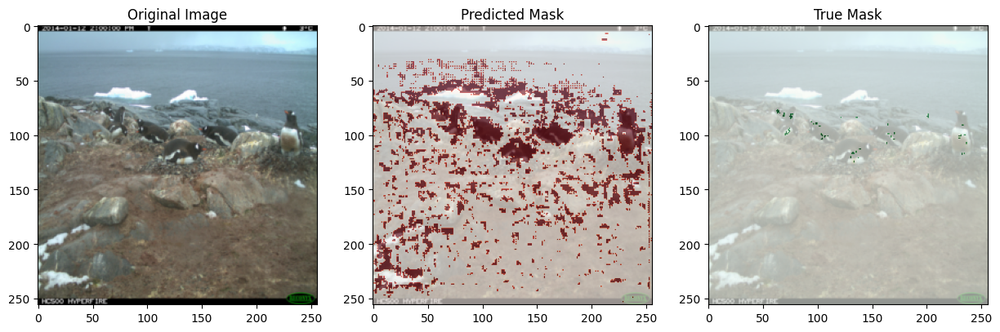

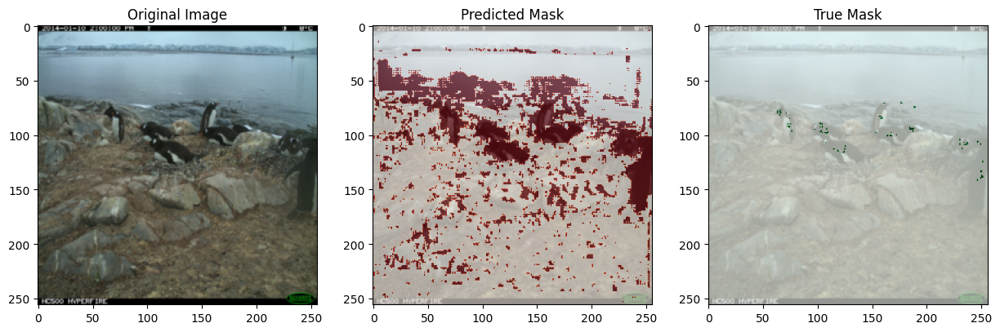

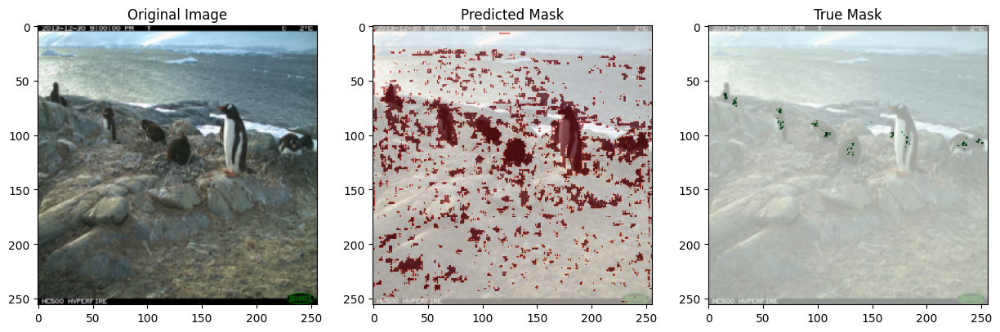

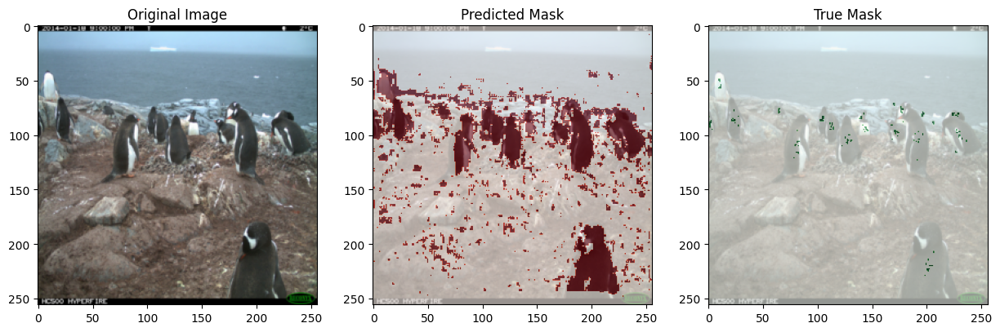

Average IoU after evaluating 2 batches: 4.338558793078017e-05


In [ ]:
def iou_score(output, target):
    smooth = 1e-6
    output = output.view(-1).cpu().numpy()
    target = target.view(-1).cpu().numpy()
    intersection = (output * target).sum()  # Logical AND
    union = (output + target).sum() - intersection  # Logical OR
    return (intersection + smooth) / (union + smooth)


# Evaluation and enhanced visualization
def visualize_prediction(images, preds, true_masks, num_images=4):
    # Determine the actual number of images to visualize in case the last batch has fewer images
    num_images = min(num_images, images.size(0))

    for i in range(num_images):
        img = images[i].cpu().numpy().transpose(1, 2, 0)
        pred_mask = preds[i].cpu().numpy().squeeze()
        true_mask = true_masks[i].cpu().numpy().squeeze()

        fig, axs = plt.subplots(1, 3, figsize=(15, 5))
        axs[0].imshow(img)
        axs[0].set_title('Original Image')
        axs[1].imshow(img)
        axs[1].imshow(pred_mask, alpha=0.6, cmap='Reds')
        axs[1].set_title('Predicted Mask')
        axs[2].imshow(img)
        axs[2].imshow(true_mask, alpha=0.6, cmap='Greens')
        axs[2].set_title('True Mask')
        plt.show()


# Evaluation function
# Switch model to evaluation mode
# Switch model to evaluation mode
model.eval()
total_iou = 0.0
num_batches_to_evaluate = 2  # Set the number of batches you want to evaluate
num_images_to_visualize_per_batch = 4  # Number of images to visualize per batch

# Track the number of processed images to average IoU correctly
processed_images = 0

with torch.no_grad():  # No gradients needed for evaluation
    for batch_index, (images, masks, _) in enumerate(val_dataloader):
        if batch_index >= num_batches_to_evaluate:
            break  # Stop evaluation after the set number of batches

        images, masks = images.to(device), masks.to(device)
        outputs = model(images)
        preds = torch.sigmoid(outputs) > 0.5  # Apply threshold
        preds = preds.float()  # Convert boolean tensor to float for IoU calculation

        # Calculate IoU and sum it up for each image in the batch
        for pred, mask in zip(preds, masks):
            total_iou += iou_score(pred, mask)
            processed_images += 1

        # Visualize the first N images of the batch, making sure not to exceed the batch size
        num_images_to_visualize = min(images.size(0), num_images_to_visualize_per_batch)
        visualize_prediction(images, preds, masks, num_images=num_images_to_visualize)

# Calculate the average IoU over all processed images
avg_iou = total_iou / processed_images
print(f'Average IoU after evaluating {num_batches_to_evaluate} batches: {avg_iou}')

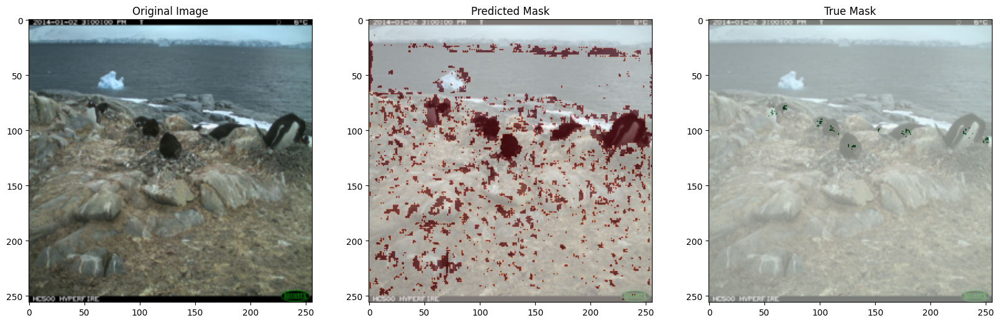

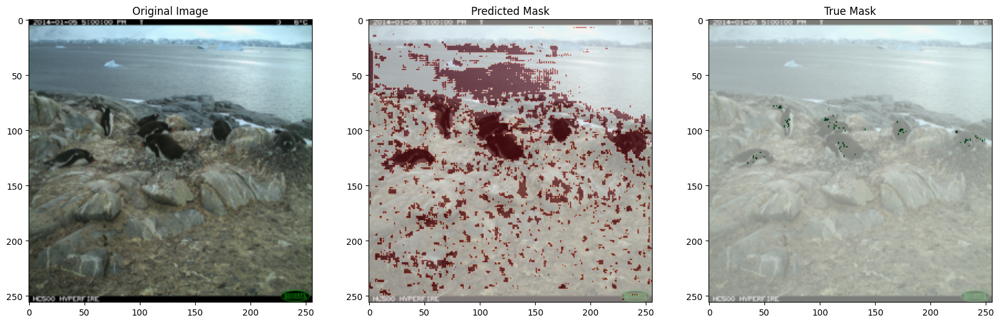

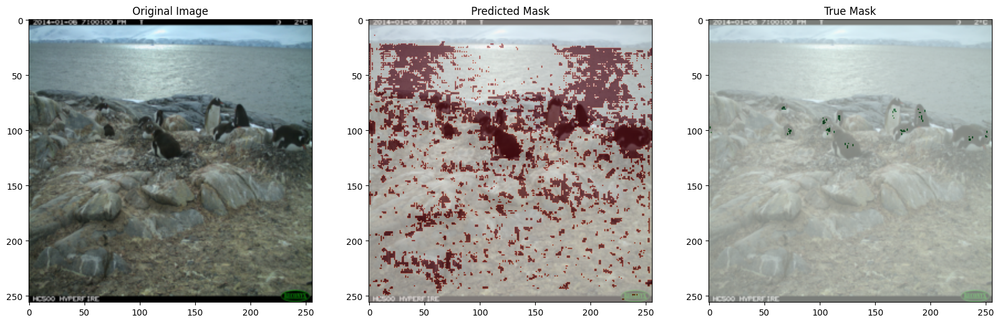

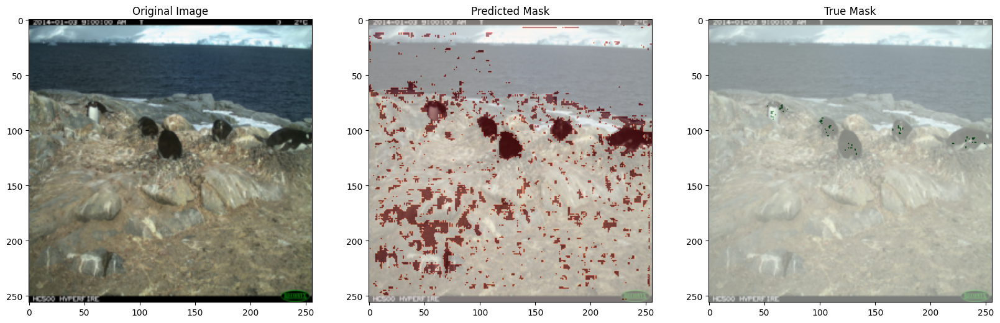

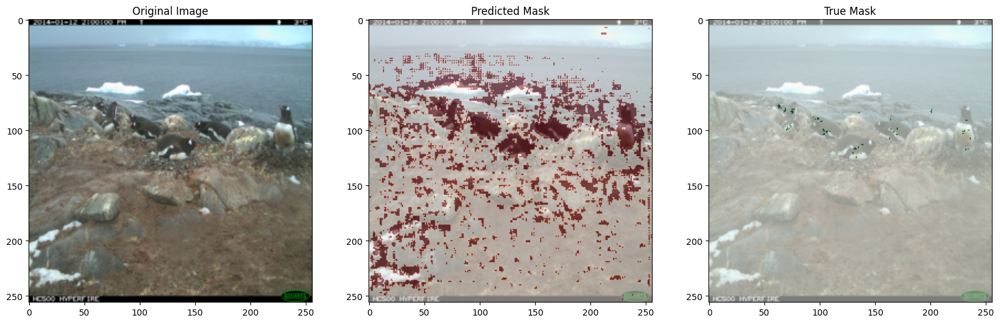

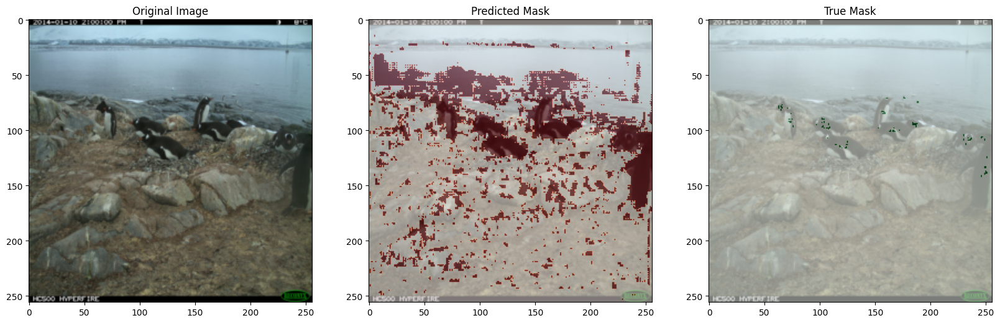

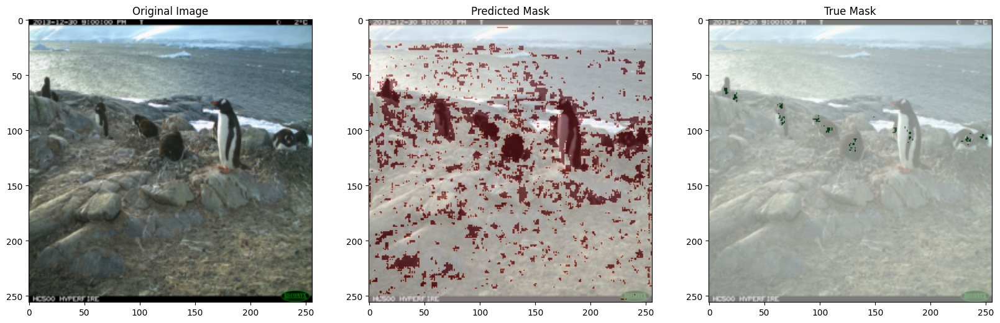

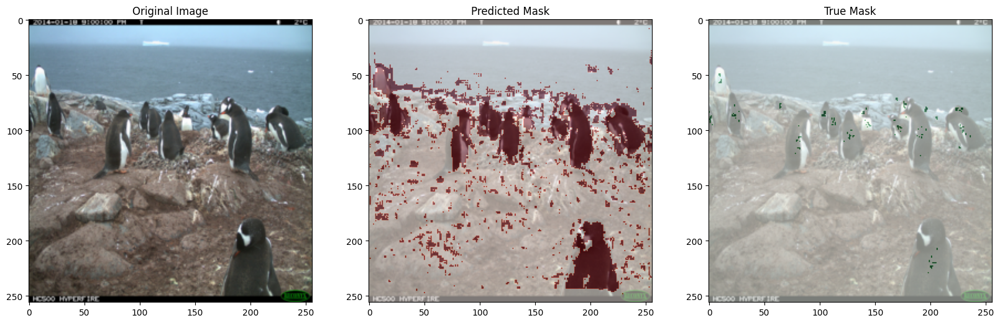

Mean Precision: 0.0000, Mean Recall: 0.0000


In [ ]:
# Assuming we have `outputs` from the model which are the raw logits
# Applying a threshold to get binary predictions
thresholded_outputs = (torch.sigmoid(outputs) > 0.5).float()

# Post-processing step: since annotations are dots, consider using a peak detection algorithm
# that identifies local maxima as penguin locations. For simplicity, let's just convert outputs to binary dots.
# In a more advanced scenario, you could use a proper peak detection method.
predictions_as_dots = torch.where(thresholded_outputs > 0.9, 1, 0)

# Evaluation Metric: Precision and Recall calculation
def calculate_precision_recall(true_masks, preds_as_dots):
    # Flatten the tensors to compare them element-wise
    true_masks_flat = true_masks.view(-1).cpu().numpy()
    preds_as_dots_flat = preds_as_dots.view(-1).cpu().numpy()

    # True positives are where both true and predicted masks are 1
    tp = np.sum((true_masks_flat == 1) & (preds_as_dots_flat == 1))
    # False positives are where the predicted mask is 1 but the true mask is 0
    fp = np.sum((true_masks_flat == 0) & (preds_as_dots_flat == 1))
    # True mask positives (total actual positives)
    total_true_positives = np.sum(true_masks_flat == 1)

    # Calculate precision and recall, with safeguards against division by zero
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / total_true_positives if total_true_positives > 0 else 0

    return precision, recall

# Visualize predictions with the original images
def visualize_predictions_with_dots(image, true_mask, predicted_dots):
    # Ensure we're working with a single image by removing the batch dimension
    # using .squeeze(0) before permuting
    img_np = image.squeeze(0).cpu().permute(1, 2, 0).numpy()  # Remove batch dim, then permute
    true_mask_np = true_mask.squeeze(0).cpu().squeeze().numpy()  # Remove batch dim, and ensure it's 2D
    pred_dots_np = predicted_dots.squeeze(0).cpu().squeeze().numpy()  # Remove batch dim, and ensure it's 2D

    fig, axs = plt.subplots(1, 3, figsize=(20, 10))
    axs[0].imshow(img_np)
    axs[0].set_title('Original Image')

    axs[1].imshow(img_np)
    axs[1].imshow(pred_dots_np, alpha=0.5, cmap='Reds')  # Assuming pred_dots_np is a mask-like structure
    axs[1].set_title('Predicted Mask')

    axs[2].imshow(img_np)
    axs[2].imshow(true_mask_np, alpha=0.5, cmap='Greens')
    axs[2].set_title('True Mask')

    plt.show()

# Main evaluation loop
model.eval()

precisions = []
recalls = []

# Parameters to limit the evaluation
max_images_to_evaluate = 8
images_evaluated = 0

with torch.no_grad():
    for images, masks, _ in val_dataloader:
        images, masks = images.to(device), masks.to(device)
        outputs = model(images)
        preds_as_dots = (torch.sigmoid(outputs) > 0.5).float()

        for i in range(images.size(0)):
            if images_evaluated >= max_images_to_evaluate:
                break
            # Extract single image predictions and true masks for precision/recall calculation
            single_image = images[i:i+1]
            single_true_mask = masks[i:i+1]
            single_pred_dots = preds_as_dots[i:i+1]

            # Calculate precision and recall for the current image
            precision, recall = calculate_precision_recall(single_true_mask, single_pred_dots)
            precisions.append(precision)
            recalls.append(recall)

            # Visualize the prediction with dots
            visualize_predictions_with_dots(single_image, single_true_mask, single_pred_dots)

            images_evaluated += 1

        if images_evaluated >= max_images_to_evaluate:
            break

# Ensure that we calculate mean precision and recall only if there are values in the lists
mean_precision = np.nanmean(precisions) if precisions else float('nan')  # np.nanmean handles empty lists and NaN values
mean_recall = np.nanmean(recalls) if recalls else float('nan')

print(f'Mean Precision: {mean_precision:.4f}, Mean Recall: {mean_recall:.4f}')


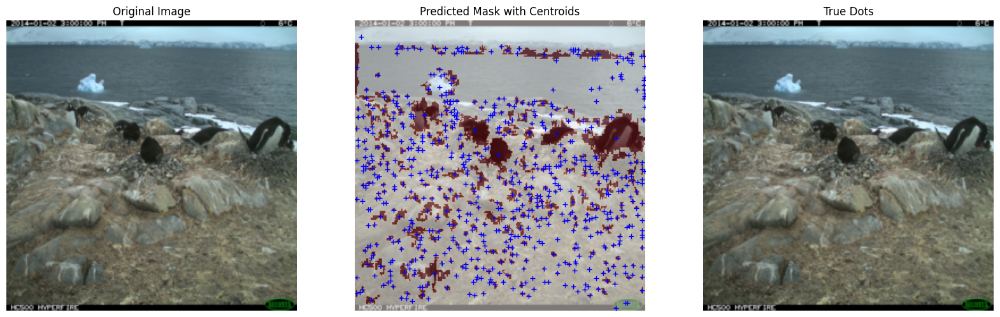

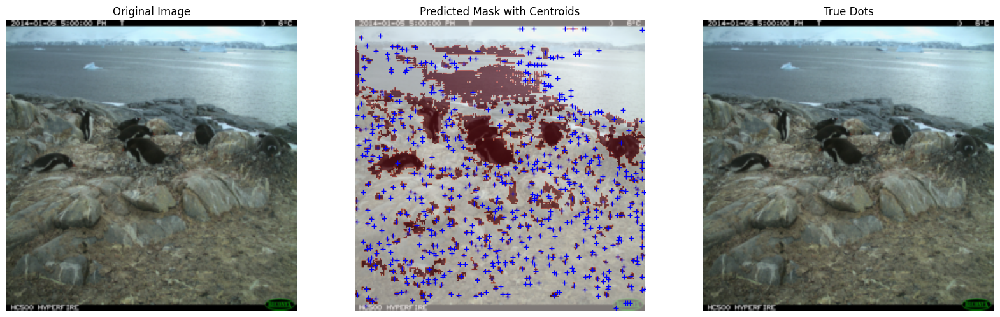

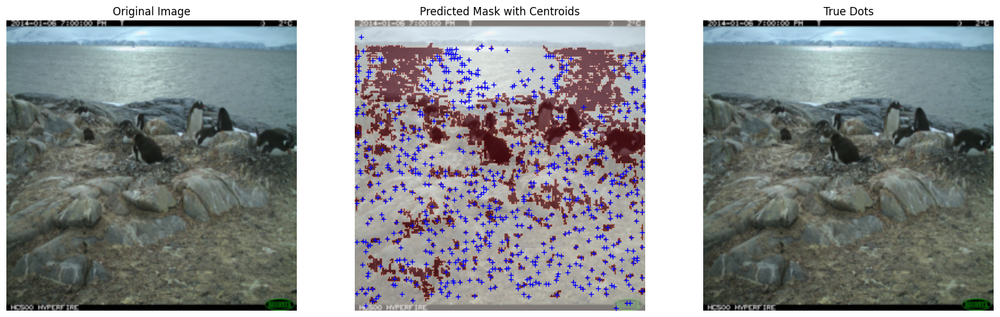

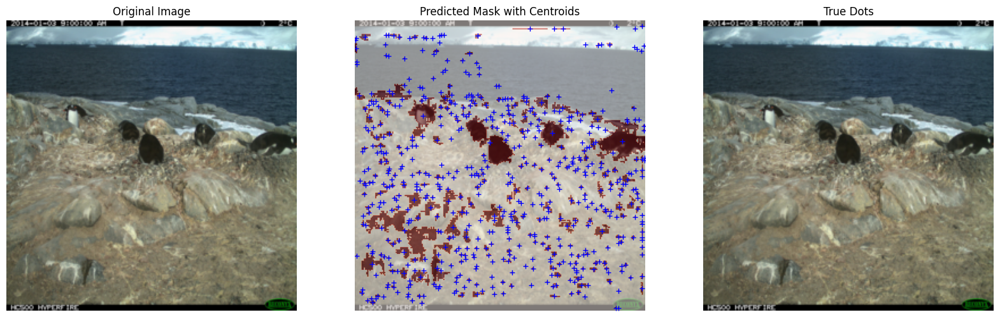

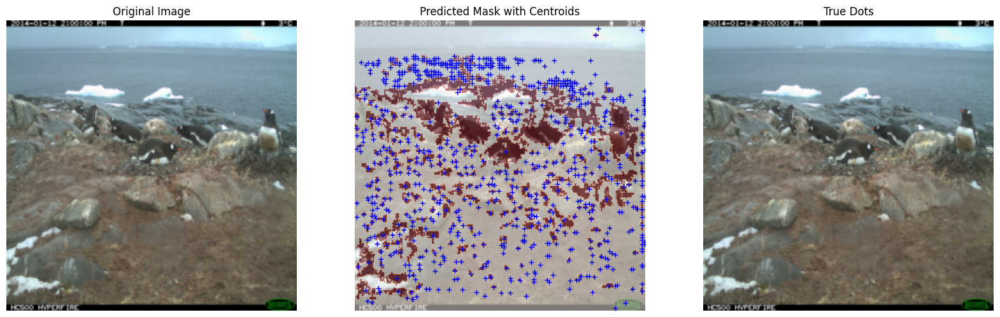

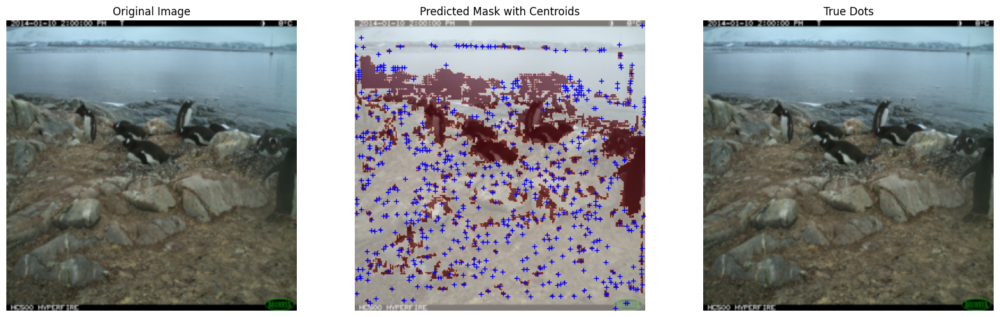

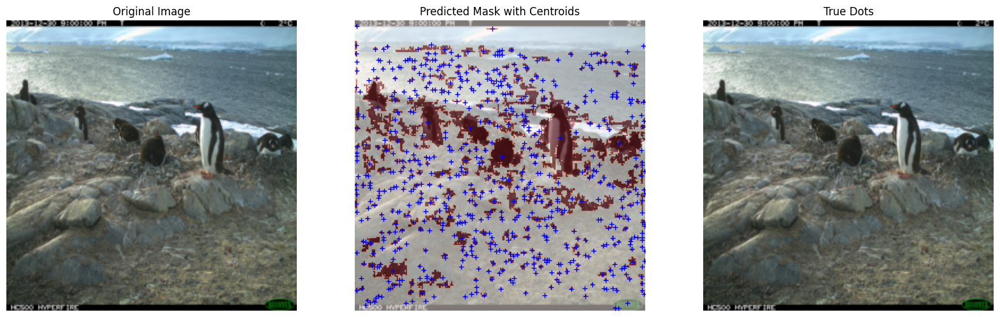

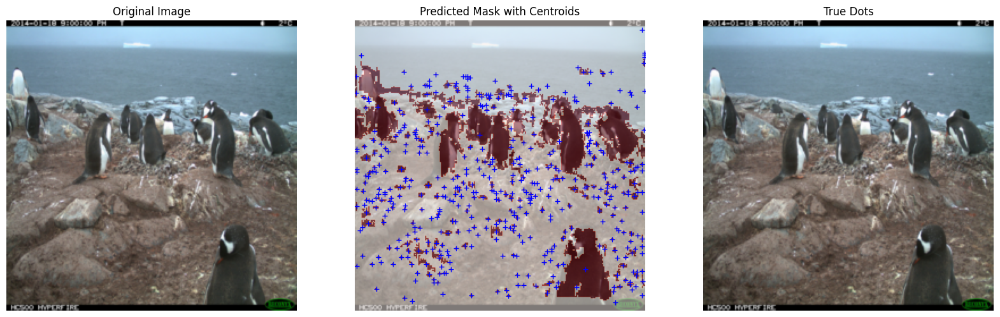

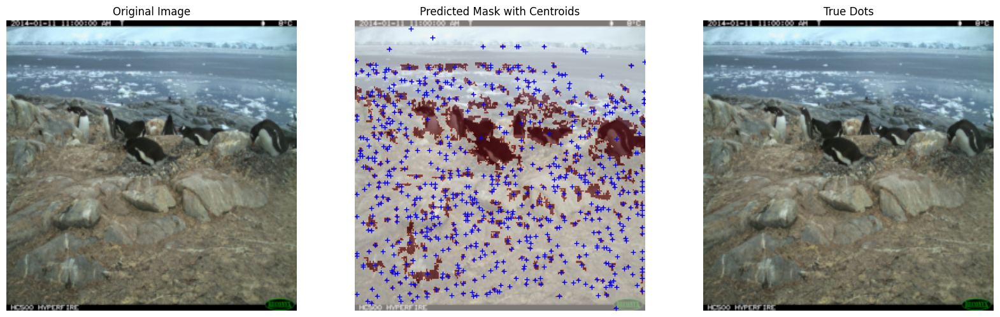

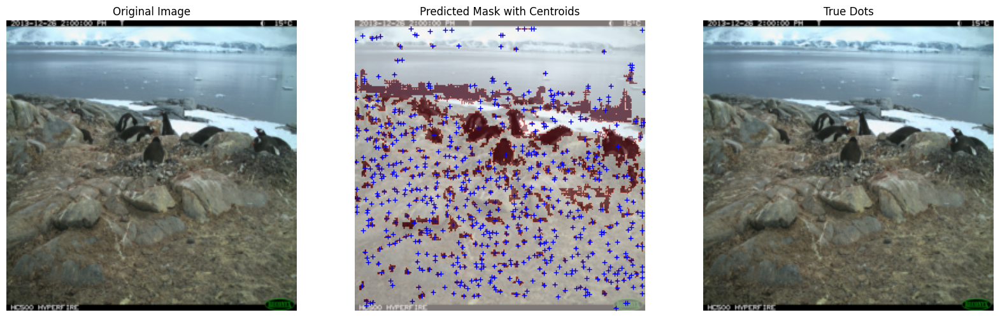

Mean Precision: 0.0000
Mean Recall: 0.0000


In [ ]:
import numpy as np
import torch
from skimage.measure import label, regionprops
from sklearn.metrics import precision_score, recall_score
import matplotlib.pyplot as plt

# Define a function to extract centroids from a binary mask
def extract_centroids(mask):
    labeled_mask = label(mask)
    props = regionprops(labeled_mask)
    centroids = [prop.centroid for prop in props]
    return centroids

# Define a function to calculate precision and recall based on centroids
def calculate_precision_recall_centroids(true_dots, pred_centroids, tolerance=3):
    # Convert true_dots list to a numpy array
    true_dots_np = np.array(true_dots)
    true_labels = np.zeros((256, 256), dtype=np.uint8)  # Assuming image size is 256x256
    for dot in true_dots_np:
        y, x = dot
        true_labels[int(y), int(x)] = 1

    pred_labels = np.zeros((256, 256), dtype=np.uint8)  # Same assumption
    for centroid in pred_centroids:
        y, x = centroid
        pred_labels[int(y), int(x)] = 1

    true_labels_flat = true_labels.flatten()
    pred_labels_flat = pred_labels.flatten()

    precision = precision_score(true_labels_flat, pred_labels_flat, zero_division=0)
    recall = recall_score(true_labels_flat, pred_labels_flat, zero_division=0)

    return precision, recall

# Function to visualize the original image, predicted mask, and true mask
def visualize(image, predicted_mask, true_dots):
    fig, axs = plt.subplots(1, 3, figsize=(20, 10))

    # Original image
    axs[0].imshow(image)
    axs[0].set_title('Original Image')
    axs[0].axis('off')

    # Predicted mask with centroids
    axs[1].imshow(image)
    axs[1].imshow(predicted_mask, alpha=0.5, cmap='Reds')
    pred_centroids = extract_centroids(predicted_mask)
    for cent in pred_centroids:
        axs[1].plot(cent[1], cent[0], 'b+')
    axs[1].set_title('Predicted Mask with Centroids')
    axs[1].axis('off')

    # True mask with annotations
    axs[2].imshow(image)
    for dot in true_dots:
        axs[2].plot(dot[1], dot[0], 'g+')
    axs[2].set_title('True Dots')
    axs[2].axis('off')

    plt.show()

# Assuming model, val_dataloader, device are already defined
model.eval()
total_precision = []
total_recall = []

# Set a limit for visualization to prevent crash
max_visualizations = 10
visualizations = 0

with torch.no_grad():
    for i, (images, masks, _) in enumerate(val_dataloader):
        images, masks = images.to(device), masks.to(device)
        outputs = model(images)
        predicted_masks = (torch.sigmoid(outputs) > 0.5).cpu().numpy().astype(np.uint8)
        true_masks_cpu = masks.cpu().numpy()  # Move masks to CPU

        for img, true_mask, pred_mask in zip(images.cpu(), true_masks_cpu, predicted_masks):  # Ensure images are also on CPU
            true_dots = [(y, x) for y, x in zip(*np.where(true_mask[0]))]
            pred_centroids = extract_centroids(pred_mask[0])

            precision, recall = calculate_precision_recall_centroids(true_dots, pred_centroids)
            total_precision.append(precision)
            total_recall.append(recall)

            if visualizations < max_visualizations:
                visualize(img.cpu().permute(1, 2, 0).numpy(), pred_mask[0], true_dots)
                visualizations += 1

        if visualizations >= max_visualizations:
            break

mean_precision = np.mean(total_precision)
mean_recall = np.mean(total_recall)

print(f"Mean Precision: {mean_precision:.4f}")
print(f"Mean Recall: {mean_recall:.4f}")
